In [1]:
import torch
from transformers import SegformerImageProcessor, SegformerForSemanticSegmentation
from ultralytics import YOLO

import cv2
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

In [2]:
image = cv2.imread("../../../assets/test/nexet(frame_9da98090-9b48-496f-a829-62daad54f574_00004-1280_720).jpg")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

In [3]:
model1 = YOLO("../../Segmentation/Pre-trained Models/yolov8m-seg.pt")  # yolov8n-seg.pt # yolov8s-seg.pt # yolov8l-seg.pt # yolov8x-seg.pt
model1.to('cuda' if torch.cuda.is_available() else 'cpu')

YOLO(
  (model): SegmentationModel(
    (model): Sequential(
      (0): Conv(
        (conv): Conv2d(3, 48, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (bn): BatchNorm2d(48, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
        (act): SiLU(inplace=True)
      )
      (1): Conv(
        (conv): Conv2d(48, 96, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (bn): BatchNorm2d(96, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
        (act): SiLU(inplace=True)
      )
      (2): C2f(
        (cv1): Conv(
          (conv): Conv2d(96, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn): BatchNorm2d(96, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
          (act): SiLU(inplace=True)
        )
        (cv2): Conv(
          (conv): Conv2d(192, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn): BatchNorm2d(96, eps=0.001, momentum=0.03, affine=True, track_runni


0: 384x640 4 persons, 1 bicycle, 7 cars, 1 truck, 2 traffic lights, 47.1ms
Speed: 6.1ms preprocess, 47.1ms inference, 137.6ms postprocess per image at shape (1, 3, 384, 640)


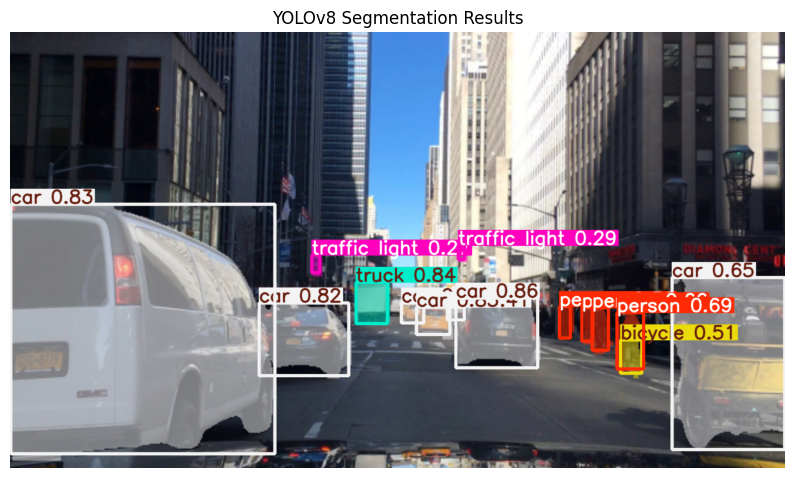

In [4]:
results1 = model1(image)[0]

plt.figure(figsize=(10, 6))
plt.imshow(results1.plot())
plt.title("YOLOv8 Segmentation Results")
plt.axis('off')
plt.show()

In [5]:
model2 = SegformerForSemanticSegmentation.from_pretrained(
    "nvidia/segformer-b2-finetuned-cityscapes-1024-1024",
    use_safetensors=True
    )
model2.to('cuda' if torch.cuda.is_available() else 'cpu')

SegformerForSemanticSegmentation(
  (segformer): SegformerModel(
    (encoder): SegformerEncoder(
      (patch_embeddings): ModuleList(
        (0): SegformerOverlapPatchEmbeddings(
          (proj): Conv2d(3, 64, kernel_size=(7, 7), stride=(4, 4), padding=(3, 3))
          (layer_norm): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        )
        (1): SegformerOverlapPatchEmbeddings(
          (proj): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
          (layer_norm): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
        )
        (2): SegformerOverlapPatchEmbeddings(
          (proj): Conv2d(128, 320, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
          (layer_norm): LayerNorm((320,), eps=1e-05, elementwise_affine=True)
        )
        (3): SegformerOverlapPatchEmbeddings(
          (proj): Conv2d(320, 512, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
          (layer_norm): LayerNorm((512,), eps=1e-05, elementwise_affine=True)

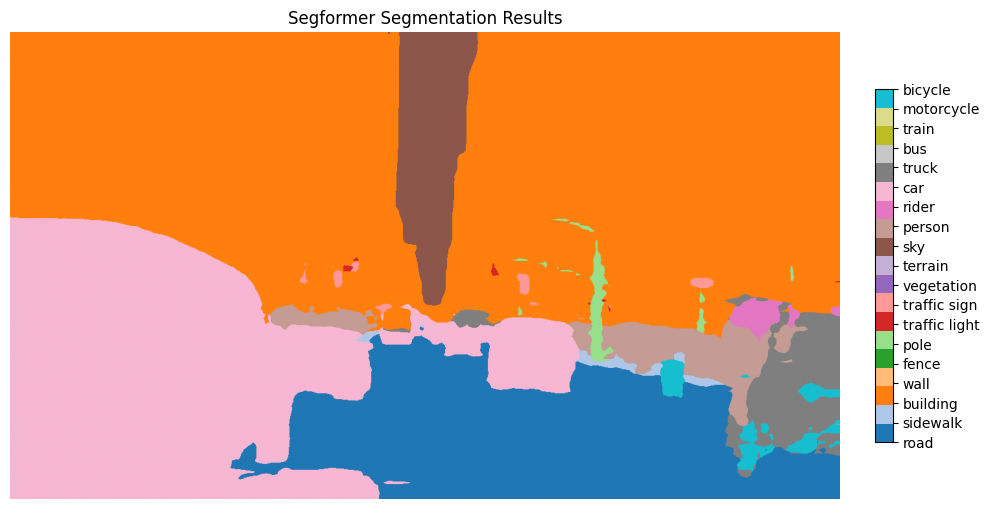

In [6]:
processor = SegformerImageProcessor()
inputs = processor(images=image, return_tensors="pt")

device = next(model2.parameters()).device
inputs = {k: v.to(device) for k, v in inputs.items()}


with torch.no_grad():
    outputs = model2(**inputs)
logits = outputs.logits  # [1, num_classes, height, width]

original_height, original_width = image.shape[:2]  # (height, width)

upsampled_logits = torch.nn.functional.interpolate(
    logits,
    size=(original_height, original_width),  # (height, width)
    mode='bilinear',
    align_corners=False
)

results2 = torch.argmax(upsampled_logits, dim=1).cpu().numpy()[0]

cityscapes_labels = [
    "road", "sidewalk", "building", "wall", "fence", "pole", "traffic light",
    "traffic sign", "vegetation", "terrain", "sky", "person", "rider", "car",
    "truck", "bus", "train", "motorcycle", "bicycle"
]

colors = plt.colormaps.get_cmap('tab20').colors[:19]
cmap = mcolors.ListedColormap(colors)

plt.figure(figsize=(10, 8))
im = plt.imshow(results2, cmap=cmap, vmin=0, vmax=len(cityscapes_labels)-1)
plt.title("Segformer Segmentation Results")
plt.axis('off')
cbar = plt.colorbar(im, ticks=range(len(cityscapes_labels)), 
                    orientation='vertical', fraction=0.02, pad=0.04)
cbar.ax.set_yticklabels(cityscapes_labels)
plt.tight_layout()
plt.show()

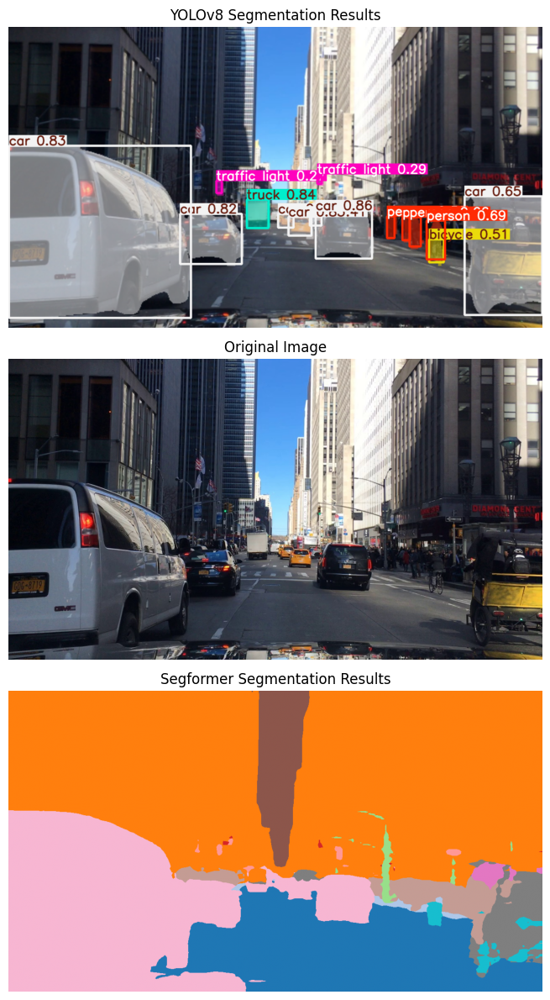

In [7]:
plt.figure(figsize=(8, 12))

# Original image
plt.subplot(3, 1, 2)
plt.imshow(image)
plt.title("Original Image")
plt.axis('off')

# YOLOv8 results
plt.subplot(3, 1, 1)
plt.imshow(results1.plot())
plt.title("YOLOv8 Segmentation Results")
plt.axis('off')

# Segformer results
plt.subplot(3, 1, 3)
plt.imshow(results2, cmap=cmap, vmin=0, vmax=len(cityscapes_labels)-1)
plt.title("Segformer Segmentation Results")
plt.axis('off')

plt.tight_layout()
plt.show()


0: 384x640 7 cars, 1 truck, 8 traffic lights, 157.0ms
Speed: 3.4ms preprocess, 157.0ms inference, 6.0ms postprocess per image at shape (1, 3, 384, 640)


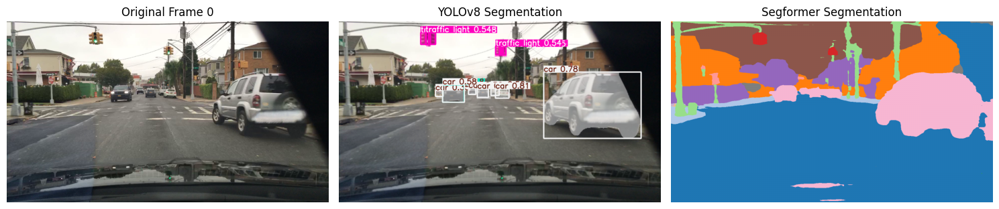


0: 384x640 8 cars, 1 truck, 4 traffic lights, 10.2ms
Speed: 0.9ms preprocess, 10.2ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


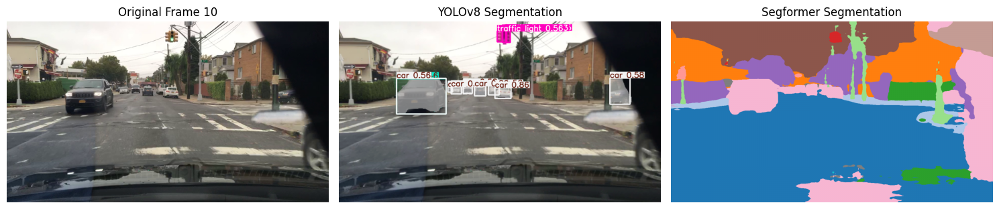


0: 384x640 6 cars, 2 trucks, 3 traffic lights, 10.1ms
Speed: 1.0ms preprocess, 10.1ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


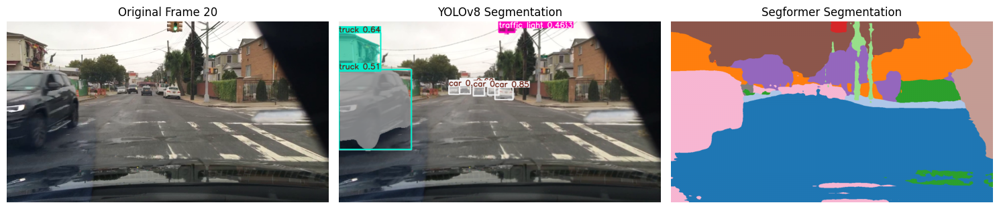


0: 384x640 5 cars, 1 truck, 10.1ms
Speed: 1.0ms preprocess, 10.1ms inference, 7.3ms postprocess per image at shape (1, 3, 384, 640)


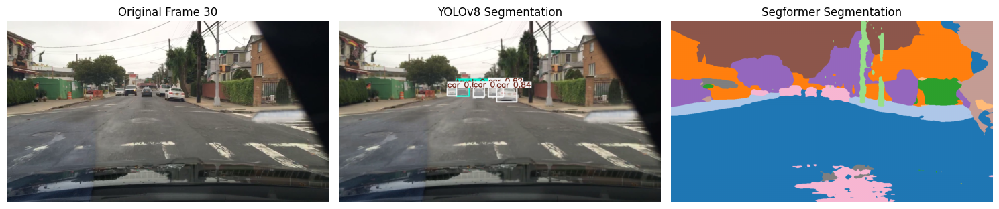


0: 384x640 6 cars, 1 truck, 10.0ms
Speed: 1.1ms preprocess, 10.0ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


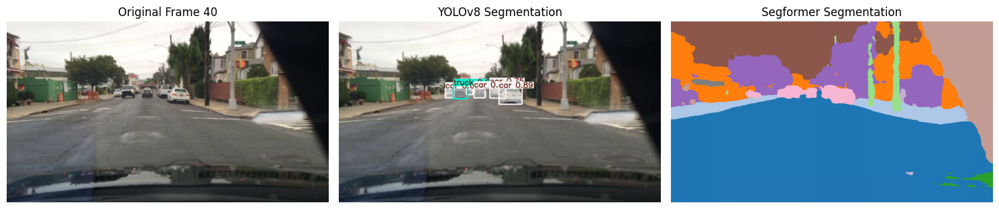


0: 384x640 6 cars, 1 truck, 3 traffic lights, 10.2ms
Speed: 1.1ms preprocess, 10.2ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


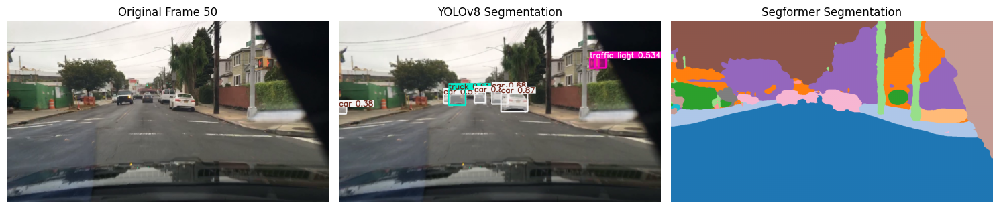


0: 384x640 4 cars, 1 truck, 11.1ms
Speed: 0.9ms preprocess, 11.1ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


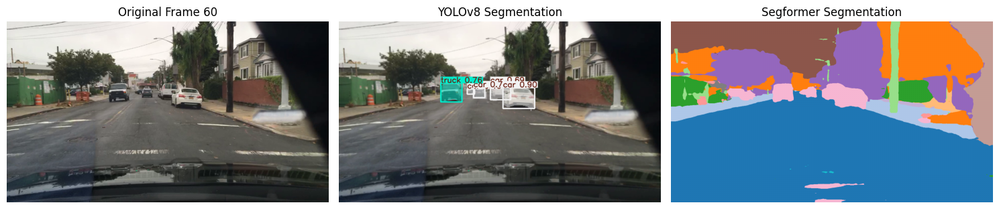


0: 384x640 5 cars, 1 truck, 10.7ms
Speed: 1.0ms preprocess, 10.7ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


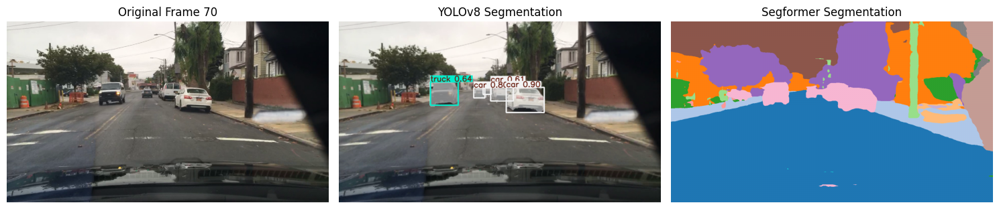


0: 384x640 4 cars, 2 trucks, 16.1ms
Speed: 1.0ms preprocess, 16.1ms inference, 4.7ms postprocess per image at shape (1, 3, 384, 640)


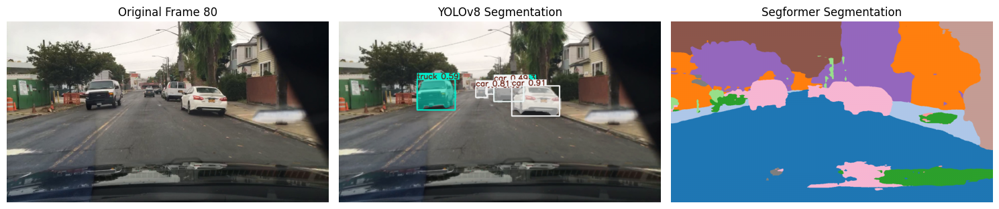


0: 384x640 4 cars, 2 trucks, 17.9ms
Speed: 1.0ms preprocess, 17.9ms inference, 3.1ms postprocess per image at shape (1, 3, 384, 640)


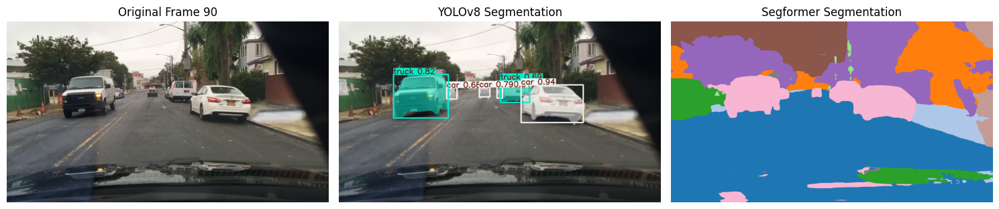


0: 384x640 5 cars, 3 trucks, 20.7ms
Speed: 1.6ms preprocess, 20.7ms inference, 5.3ms postprocess per image at shape (1, 3, 384, 640)


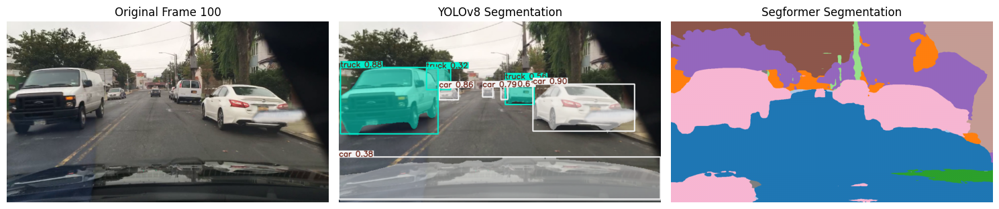


0: 384x640 6 cars, 2 trucks, 24.9ms
Speed: 1.4ms preprocess, 24.9ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)


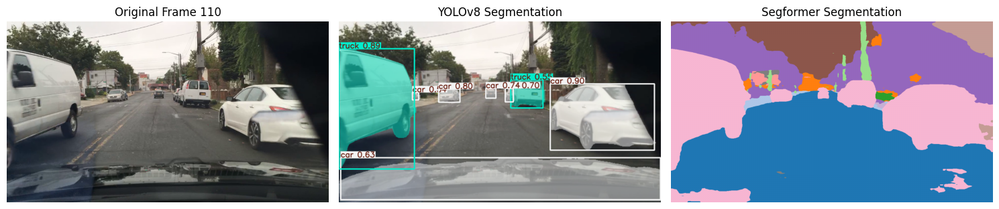


0: 384x640 7 cars, 1 truck, 20.5ms
Speed: 1.3ms preprocess, 20.5ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)


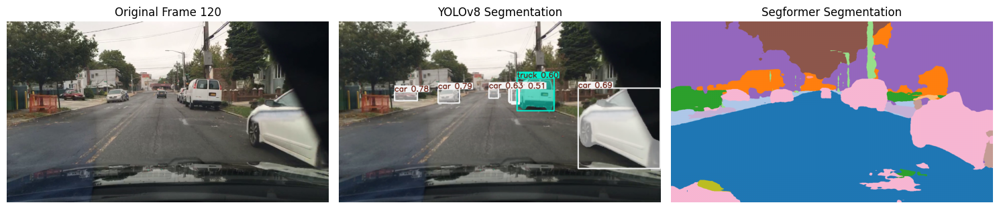


0: 384x640 7 cars, 1 truck, 18.8ms
Speed: 1.3ms preprocess, 18.8ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


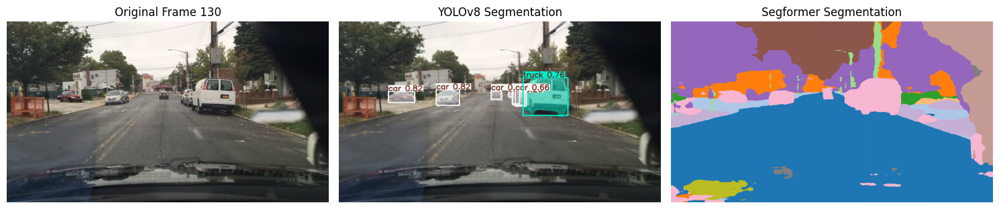


0: 384x640 6 cars, 1 truck, 18.0ms
Speed: 1.0ms preprocess, 18.0ms inference, 3.2ms postprocess per image at shape (1, 3, 384, 640)


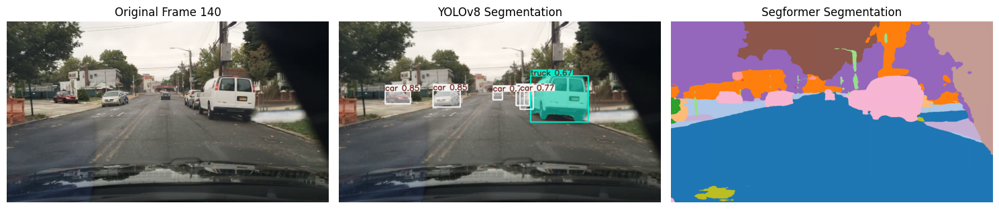


0: 384x640 7 cars, 1 truck, 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


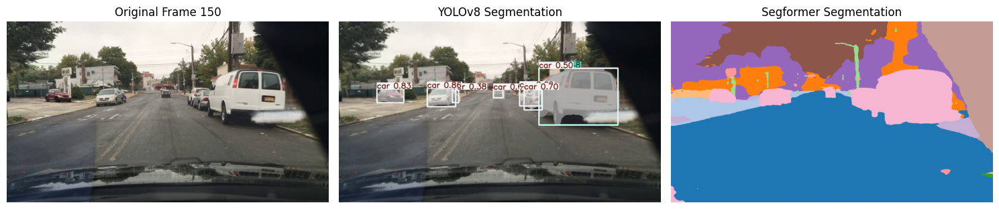


0: 384x640 8 cars, 18.1ms
Speed: 1.2ms preprocess, 18.1ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)


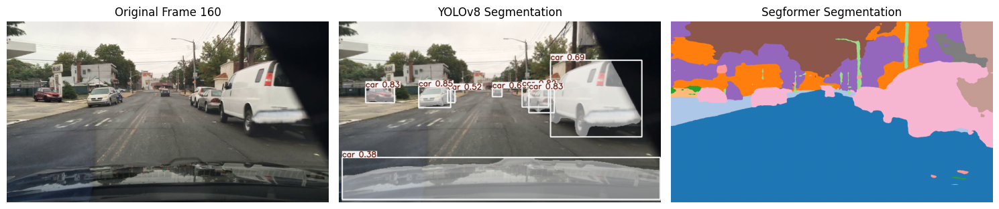


0: 384x640 9 cars, 27.8ms
Speed: 1.4ms preprocess, 27.8ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


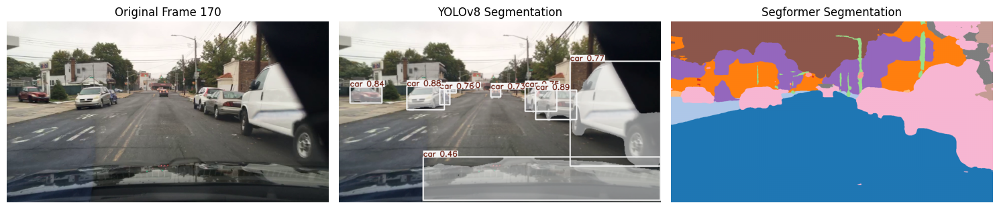


0: 384x640 8 cars, 1 truck, 22.1ms
Speed: 1.5ms preprocess, 22.1ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


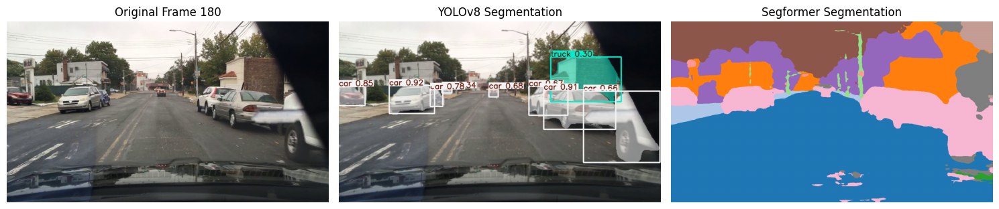


0: 384x640 9 cars, 22.2ms
Speed: 1.3ms preprocess, 22.2ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


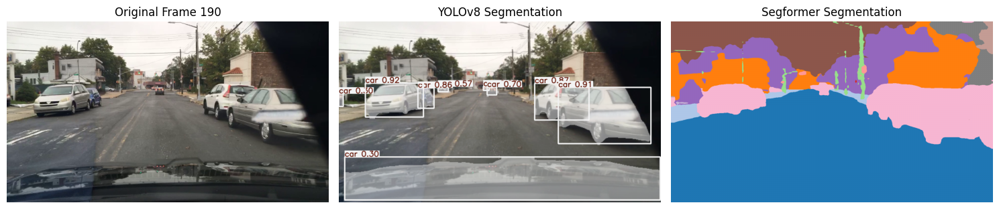


0: 384x640 10 cars, 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


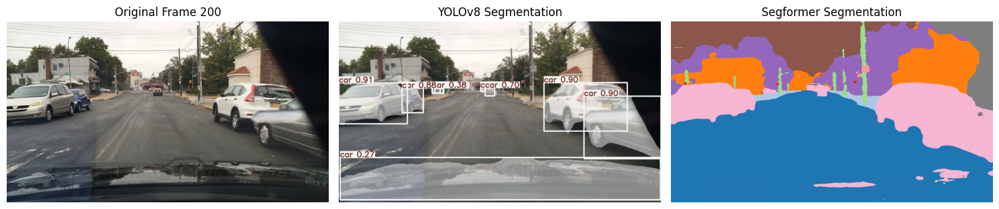


0: 384x640 7 cars, 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


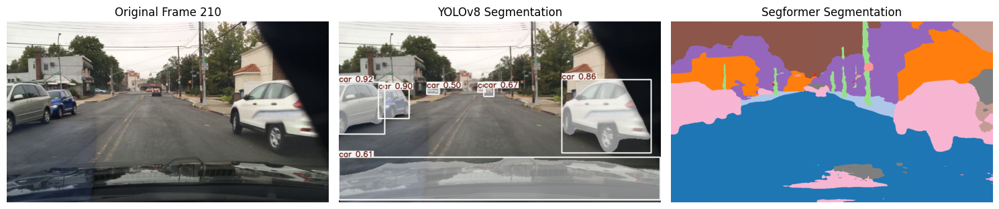


0: 384x640 7 cars, 1 bus, 1 truck, 21.2ms
Speed: 1.4ms preprocess, 21.2ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)


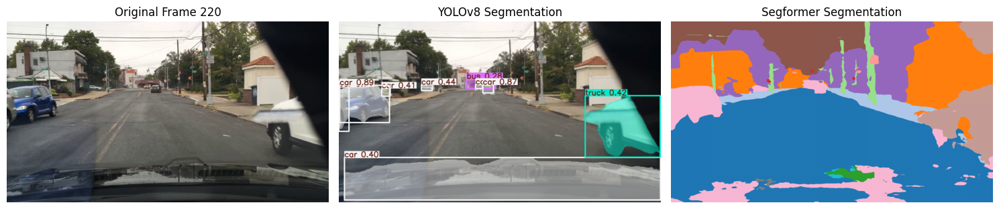


0: 384x640 6 cars, 27.3ms
Speed: 1.3ms preprocess, 27.3ms inference, 4.6ms postprocess per image at shape (1, 3, 384, 640)


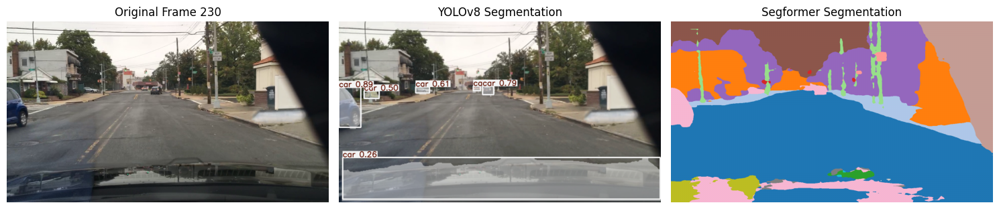


0: 384x640 5 cars, 21.7ms
Speed: 1.7ms preprocess, 21.7ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


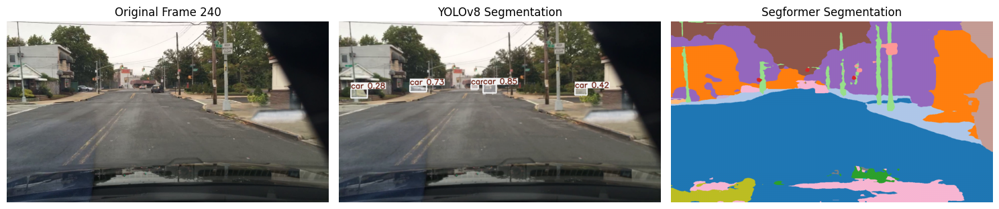


0: 384x640 4 cars, 1 train, 23.3ms
Speed: 2.0ms preprocess, 23.3ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


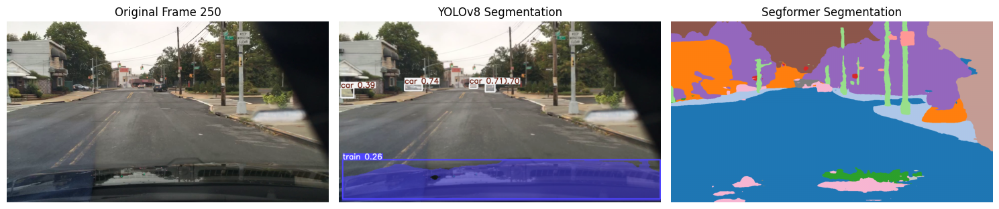


0: 384x640 4 cars, 1 traffic light, 20.3ms
Speed: 1.3ms preprocess, 20.3ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


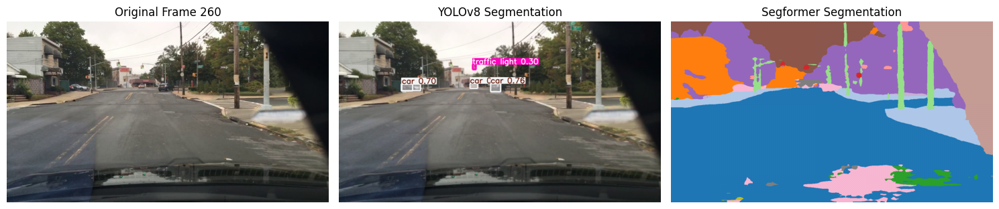


0: 384x640 4 cars, 21.0ms
Speed: 1.3ms preprocess, 21.0ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


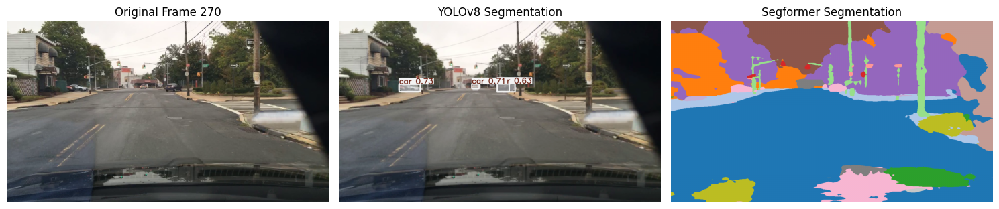


0: 384x640 5 cars, 20.7ms
Speed: 1.4ms preprocess, 20.7ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


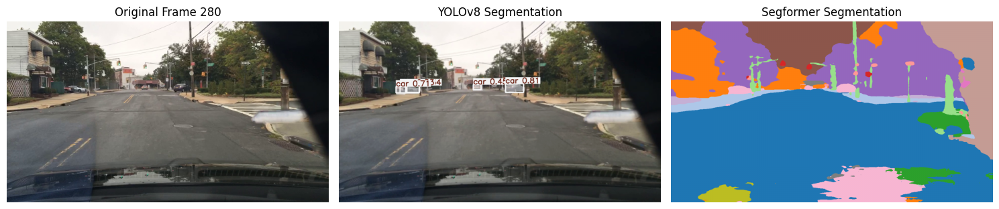


0: 384x640 4 cars, 1 traffic light, 26.3ms
Speed: 1.4ms preprocess, 26.3ms inference, 4.8ms postprocess per image at shape (1, 3, 384, 640)


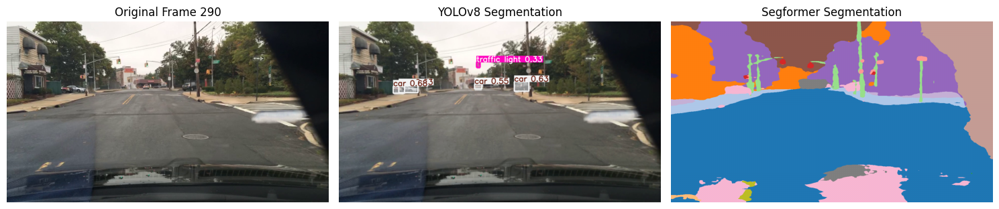


0: 384x640 4 cars, 2 traffic lights, 21.7ms
Speed: 1.5ms preprocess, 21.7ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


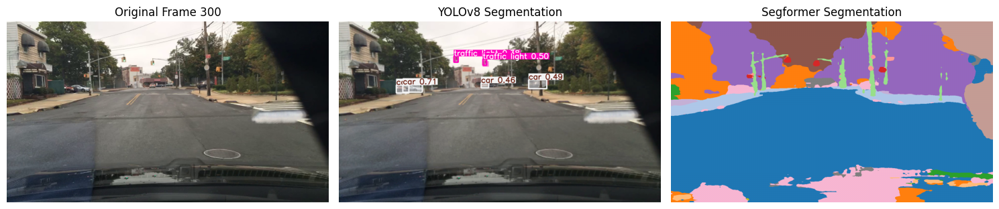

: 

In [ ]:
# Load one example of bdd100k videos dataset

video = cv2.VideoCapture("../../../Dataset/BDD100K/Videos/bdd100k_videos_train_00/bdd100k/videos/train/00a0f008-3c67908e.mov")
frame_count = 0
skip_frames = 10  # Process every 10th frame for faster processing

# Get device for moving inputs
device = next(model2.parameters()).device

while video.isOpened():
    ret, frame = video.read()
    if not ret:
        break
    
    # Skip frames for faster processing
    if frame_count % skip_frames != 0:
        frame_count += 1
        continue
    
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    
    # Process the frame with YOLOv8
    results1 = model1(frame)[0]
    
    # Process the frame with Segformer
    inputs = processor(images=frame, return_tensors="pt")
    inputs = {k: v.to(device) for k, v in inputs.items()}
    
    with torch.no_grad():
        outputs = model2(**inputs)
    logits = outputs.logits
    upsampled_logits = torch.nn.functional.interpolate(
        logits,
        size=(frame.shape[0], frame.shape[1]),
        mode='bilinear',
        align_corners=False
    )
    results2 = torch.argmax(upsampled_logits, dim=1).cpu().numpy()[0]
    
    # Create video-like display
    plt.figure(figsize=(15, 5))
    
    # Original frame
    plt.subplot(1, 3, 1)
    plt.imshow(frame)
    plt.title(f"Original Frame {frame_count}")
    plt.axis('off')
    # YOLOv8 results
    plt.subplot(1, 3, 2)
    plt.imshow(results1.plot())
    plt.title("YOLOv8 Segmentation")
    plt.axis('off')
    # Segformer results
    plt.subplot(1, 3, 3)
    plt.imshow(results2, cmap=cmap, vmin=0, vmax=len(cityscapes_labels)-1)
    plt.title("Segformer Segmentation")
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()
    plt.pause(0.1)  # Brief pause to create video-like effect
    plt.close()  # Close figure to prevent memory issues
    
    frame_count += 1
    
    # Optional: break after processing certain number of frames
    if frame_count > 300:  # Stop after ~10 seconds worth of frames
        break

video.release()

Testing main Musician class with 'test' type:
18:48:54 INFO music_generator.musician: 🎵 Musician initialized: test
No masks found in YOLOv8 results, using Segformer segmentation...
Segmentation map shape: (720, 1280)
Unique classes in segmentation: [ 0  1  2  5  6  7 10 11 12 13 14 18]
18:48:54 INFO music_generator.musician: 🎵 Initializing Test Musician...
18:48:54 INFO music_generator.musician: ✅ Test Musician initialized successfully
Generated 6 total music events
Edge-collision events: 6 out of 6


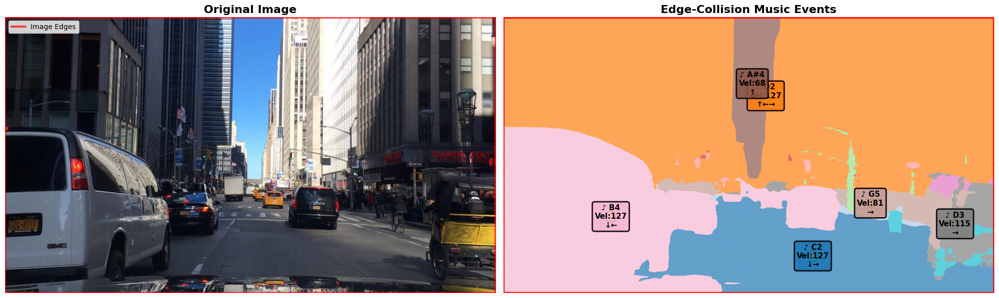


🎵 COMPLETE EDGE-COLLISION MUSIC MAPPING
🎯 ROAD → ♪ C2 (piano)
   Velocity: 127/127 | Duration: 0.19s
   Edges touched: bottom, right (2 edges)
   Presence: 14.9%

🎯 BUILDING → ♪ D2 (piano)
   Velocity: 127/127 | Duration: 2.03s
   Edges touched: top, left, right (3 edges)
   Presence: 51.3%

🎯 SKY → ♪ A#4 (piano)
   Velocity: 68/127 | Duration: 0.27s
   Edges touched: top (1 edges)
   Presence: 3.9%

🎯 PERSON → ♪ G5 (piano)
   Velocity: 81/127 | Duration: 0.37s
   Edges touched: right (1 edges)
   Presence: 2.7%

🎯 CAR → ♪ B4 (piano)
   Velocity: 127/127 | Duration: 0.36s
   Edges touched: bottom, left (2 edges)
   Presence: 22.3%

🎯 TRUCK → ♪ D3 (piano)
   Velocity: 115/127 | Duration: 0.53s
   Edges touched: right (1 edges)
   Presence: 2.8%

📊 SUMMARY: 6 edge-collision events generated

🎵 Synthesizing audio from 6 edge-collision music events...
🔊 Playing generated audio...
Music generation test completed successfully!



👆 Click the play button above to hear the generated music! 🎵


In [11]:
import numpy as np
from IPython.display import Audio, display

import os
import sys
sys.path.append(os.path.join(os.path.dirname(os.getcwd()), '..', '..'))
from modules.Music_Generator.Musician import Musician, TestMusician

def synthesize_audio(music_frame, sample_rate=44100, duration=3.0):
    """
    Convert MusicFrame events to audio waveform using piano-like synthesis.
    
    Args:
        music_frame: MusicFrame object with music events
        sample_rate: Audio sample rate (Hz)
        duration: Total duration of audio (seconds)
    
    Returns:
        numpy array with audio waveform
    """
    # Create time array
    t = np.linspace(0, duration, int(sample_rate * duration))
    audio = np.zeros_like(t)
    
    # Convert MIDI note to frequency
    def midi_to_freq(midi_note):
        return 440.0 * (2.0 ** ((midi_note - 69) / 12.0))
    
    # Synthesize each event as piano notes
    for event in music_frame.events:
        freq = midi_to_freq(event.note)
        velocity_factor = event.velocity / 127.0
        
        # Create piano-like sound for this event
        event_duration = min(event.duration, duration)
        event_samples = int(sample_rate * event_duration)
        
        if event_samples > 0:
            # Generate time array for this event
            t_event = np.linspace(0, event_duration, event_samples)
            
            # Piano-like envelope (sharp attack, gradual decay)
            envelope = np.exp(-2 * t_event / event_duration)  # Exponential decay
            
            # Piano-like waveform (fundamental + harmonics)
            fundamental = np.sin(2 * np.pi * freq * t_event)
            harmonic2 = 0.5 * np.sin(2 * np.pi * freq * 2 * t_event)  # Octave
            harmonic3 = 0.25 * np.sin(2 * np.pi * freq * 3 * t_event)  # Fifth
            
            # Combine harmonics for piano-like timbre
            wave = (fundamental + harmonic2 + harmonic3) * envelope
            
            # Apply velocity and mix into main audio
            wave *= velocity_factor * 0.2  # Scale down to prevent clipping
            
            # Add to main audio (simple mixing)
            if len(wave) <= len(audio):
                audio[:len(wave)] += wave
    
    # Normalize to prevent clipping
    if np.max(np.abs(audio)) > 0:
        audio = audio / np.max(np.abs(audio)) * 0.8
    
    return audio

def check_edge_collision(seg_map, class_id):
    """
    Check if a class touches any of the four edges of the image.
    
    Args:
        seg_map: Segmentation map
        class_id: Class ID to check
    
    Returns:
        dict: Which edges are touched {'top': bool, 'bottom': bool, 'left': bool, 'right': bool}
    """
    class_mask = (seg_map == class_id)
    height, width = seg_map.shape
    
    edges_touched = {
        'top': False,
        'bottom': False,
        'left': False,
        'right': False
    }
    
    if np.any(class_mask):
        # Check top edge (row 0)
        edges_touched['top'] = np.any(class_mask[0, :])
        
        # Check bottom edge (last row)
        edges_touched['bottom'] = np.any(class_mask[height-1, :])
        
        # Check left edge (column 0)
        edges_touched['left'] = np.any(class_mask[:, 0])
        
        # Check right edge (last column)
        edges_touched['right'] = np.any(class_mask[:, width-1])
    
    return edges_touched

def filter_edge_events(seg_map, music_frame):
    """
    Filter music events to only include those from objects touching image edges.
    
    Args:
        seg_map: Segmentation map
        music_frame: Original music frame
    
    Returns:
        Filtered music frame with only edge-touching events
    """
    filtered_events = []
    
    for event in music_frame.events:
        class_id = event.metadata.get('class_id', 0)
        class_name = event.metadata['class_name']
        
        # Check if this class touches any edge
        edges_touched = check_edge_collision(seg_map, class_id)
        
        if any(edges_touched.values()):  # If touches any edge
            # Add edge information to metadata
            event.metadata['edges_touched'] = edges_touched
            event.metadata['edge_collision'] = True
            
            # Count how many edges are touched
            num_edges_touched = sum(edges_touched.values())
            event.metadata['num_edges_touched'] = num_edges_touched
            
            # Increase velocity based on number of edges touched (more dramatic for corner objects)
            edge_multiplier = 1.0 + (num_edges_touched * 0.3)  # 30% boost per edge
            event.velocity = min(127, int(event.velocity * edge_multiplier))
            
            filtered_events.append(event)
    
    # Create new music frame with filtered events
    filtered_frame = type(music_frame)(
        events=filtered_events,
        frame_id=music_frame.frame_id,
        timestamp=music_frame.timestamp,
        tempo=music_frame.tempo,
        key_signature=music_frame.key_signature,
        metadata={
            **music_frame.metadata,
            'edge_filtered': True,
            'original_events_count': len(music_frame.events),
            'filtered_events_count': len(filtered_events)
        }
    )
    
    return filtered_frame

def visualize_music_on_segmentation_with_edges(seg_map, music_frame, original_image):
    """
    Visualize musical notes and instruments directly on the segmentation map,
    highlighting edge collisions.
    
    Args:
        seg_map: Segmentation map
        music_frame: Generated music frame (edge-filtered)
        original_image: Original image
    """
    # MIDI note to note name conversion
    def midi_to_note_name(midi_note):
        notes = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']
        octave = (midi_note // 12) - 1
        note = notes[midi_note % 12]
        return f"{note}{octave}"
    
    # Create figure with subplots
    fig, axes = plt.subplots(1, 2, figsize=(20, 10))
    
    # Plot 1: Original image (clean, no annotations)
    axes[0].imshow(original_image)
    axes[0].set_title("Original Image", fontsize=16, fontweight='bold')
    axes[0].axis('off')
    
    # Add edge indicators to original image
    height, width = original_image.shape[:2]
    # Draw edge lines
    axes[0].axhline(y=0, color='red', linewidth=3, alpha=0.7, label='Image Edges')
    axes[0].axhline(y=height-1, color='red', linewidth=3, alpha=0.7)
    axes[0].axvline(x=0, color='red', linewidth=3, alpha=0.7)
    axes[0].axvline(x=width-1, color='red', linewidth=3, alpha=0.7)
    axes[0].legend(loc='upper left')
    
    # Plot 2: Segmentation map with musical annotations
    # Create colormap for segmentation
    cityscapes_labels = [
        "road", "sidewalk", "building", "wall", "fence", "pole", "traffic light",
        "traffic sign", "vegetation", "terrain", "sky", "person", "rider", "car",
        "truck", "bus", "train", "motorcycle", "bicycle"
    ]
    
    colors = plt.colormaps.get_cmap('tab20').colors[:len(cityscapes_labels)]
    cmap = mcolors.ListedColormap(colors)
    
    axes[1].imshow(seg_map, cmap=cmap, vmin=0, vmax=len(cityscapes_labels)-1, alpha=0.7)
    axes[1].set_title("Edge-Collision Music Events", fontsize=16, fontweight='bold')
    axes[1].axis('off')
    
    # Use the same colormap for annotation boxes to match segmentation colors
    def get_class_color(class_id):
        """Get the color for a specific class from the segmentation colormap"""
        if class_id < len(colors):
            return colors[class_id]
        else:
            return colors[class_id % len(colors)]  # Wrap around if needed
    
    # Group events by class and find centroid of each segmented region
    events_by_class = {}
    for event in music_frame.events:
        class_id = event.metadata.get('class_id', 0)
        class_name = event.metadata['class_name']
        if class_id not in events_by_class:
            events_by_class[class_id] = {
                'event': event,
                'class_name': class_name
            }
    
    # Find centroids of each class region and add annotations
    for class_id, info in events_by_class.items():
        event = info['event']
        class_name = info['class_name']
        
        # Find pixels belonging to this class
        class_mask = (seg_map == class_id)
        
        if np.any(class_mask):
            # Find centroid of the class region
            y_coords, x_coords = np.where(class_mask)
            if len(y_coords) > 0:
                centroid_y = int(np.mean(y_coords))
                centroid_x = int(np.mean(x_coords))
                
                # Create annotation text
                note_name = midi_to_note_name(event.note)
                velocity = event.velocity
                
                # Get edge information
                edges_touched = event.metadata.get('edges_touched', {})
                edge_symbols = []
                if edges_touched.get('top'): edge_symbols.append('↑')
                if edges_touched.get('bottom'): edge_symbols.append('↓')
                if edges_touched.get('left'): edge_symbols.append('←')
                if edges_touched.get('right'): edge_symbols.append('→')
                
                edge_text = ''.join(edge_symbols) if edge_symbols else ''
                
                # Create clean annotation with just note and velocity
                annotation_text = f"♪ {note_name}\nVel:{velocity}\n{edge_text}"
                
                # Use segmentation map color for the annotation box
                seg_color = get_class_color(class_id)
                
                # Add annotation only to segmentation map
                bbox_props = dict(boxstyle="round,pad=0.3", facecolor=seg_color, alpha=0.9, edgecolor='black', linewidth=2)
                axes[1].text(centroid_x, centroid_y, annotation_text, 
                           fontsize=11, fontweight='bold', color='black', 
                           ha='center', va='center', bbox=bbox_props)
                
                # Add a circle with size based on number of edges touched
                num_edges = event.metadata.get('num_edges_touched', 1)
                circle_size = 8 + (num_edges * 3)  # Bigger circle for more edge touches
                circle = plt.Circle((centroid_x, centroid_y), circle_size, facecolor='yellow', fill=True, alpha=0.8, edgecolor='black', linewidth=2)
                axes[1].add_patch(circle)
    
    # Add edge indicators to segmentation map
    axes[1].axhline(y=0, color='red', linewidth=3, alpha=0.9, label='Collision Edges')
    axes[1].axhline(y=seg_map.shape[0]-1, color='red', linewidth=3, alpha=0.9)
    axes[1].axvline(x=0, color='red', linewidth=3, alpha=0.9)
    axes[1].axvline(x=seg_map.shape[1]-1, color='red', linewidth=3, alpha=0.9)
    
    plt.tight_layout()
    plt.show()

def print_complete_music_mapping(music_frame):
    """
    Print detailed music mapping for ALL events without truncation.
    
    Args:
        music_frame: Generated music frame (edge-filtered)
    """
    # MIDI note to note name conversion
    def midi_to_note_name(midi_note):
        notes = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']
        octave = (midi_note // 12) - 1
        note = notes[midi_note % 12]
        return f"{note}{octave}"
    
    # Print detailed music mapping
    print("\n" + "="*80)
    print("🎵 COMPLETE EDGE-COLLISION MUSIC MAPPING")
    print("="*80)
    
    if len(music_frame.events) == 0:
        print("🚫 No objects touching image edges - no music generated!")
        return
    
    # Group events by class
    events_by_class = {}
    for event in music_frame.events:
        class_id = event.metadata.get('class_id', 0)
        class_name = event.metadata['class_name']
        if class_id not in events_by_class:
            events_by_class[class_id] = {
                'event': event,
                'class_name': class_name
            }
    
    # Print all events in order
    for idx, (class_id, info) in enumerate(events_by_class.items(), 1):
        event = info['event']
        class_name = info['class_name']
        note_name = midi_to_note_name(event.note)
        
        edges_touched = event.metadata.get('edges_touched', {})
        edge_list = [edge for edge, touched in edges_touched.items() if touched]
        
        print(f"🎯 {class_name.upper()} → ♪ {note_name} (piano)")
        print(f"   Velocity: {event.velocity}/127 | Duration: {event.duration:.2f}s")
        print(f"   Edges touched: {', '.join(edge_list)} ({len(edge_list)} edges)")
        print(f"   Presence: {event.metadata.get('presence_ratio', 0):.1%}")
        print()
    
    print(f"📊 SUMMARY: {len(music_frame.events)} edge-collision events generated")
    print("="*80)

print("Testing main Musician class with 'test' type:")
musician = Musician(musician_type='test', tempo=120, key_signature="C_major")

# Use last segmentation map - need to extract the masks from YOLOv8 results
# Convert YOLOv8 results to segmentation map format
if hasattr(results2, 'masks') and results2.masks is not None:
    # Extract segmentation masks from YOLOv8 results
    masks = results2.masks.data.cpu().numpy()  # Shape: (N, H, W)
    seg_map = np.zeros((masks.shape[1], masks.shape[2]), dtype=int)
    
    # Assign class IDs to pixels based on masks
    for i, mask in enumerate(masks):
        class_id = int(results2.boxes.cls[i].cpu().numpy()) if results2.boxes is not None else i
        seg_map[mask > 0.5] = class_id
else:
    # If no masks, use the Segformer results instead
    print("No masks found in YOLOv8 results, using Segformer segmentation...")
    seg_map = results2

print(f"Segmentation map shape: {seg_map.shape}")
print(f"Unique classes in segmentation: {np.unique(seg_map)}")

# Generate music using the correct method (callable)
original_music_frame = musician(seg_map, frame_id=1)

print(f"Generated {len(original_music_frame.events)} total music events")

# Filter events to only include edge-colliding objects
filtered_music_frame = filter_edge_events(seg_map, original_music_frame)

print(f"Edge-collision events: {len(filtered_music_frame.events)} out of {len(original_music_frame.events)}")

# Visualize the music mapping for edge-collision events only
visualize_music_on_segmentation_with_edges(seg_map, filtered_music_frame, image)

# Print COMPLETE music mapping without truncation
print_complete_music_mapping(filtered_music_frame)

# Convert to audio and play (only edge-collision events)
if len(filtered_music_frame.events) > 0:
    print(f"\n🎵 Synthesizing audio from {len(filtered_music_frame.events)} edge-collision music events...")
    audio_data = synthesize_audio(filtered_music_frame, duration=4.0)
    
    print("🔊 Playing generated audio...")
    print("Music generation test completed successfully!")
    
    # Create and display audio widget
    audio_widget = Audio(audio_data, rate=44100, autoplay=False)
    display(audio_widget)
    
    print("\n👆 Click the play button above to hear the generated music! 🎵")
    
else:
    print("\n🔇 No edge-collision events found - no audio to play!")
    print("Try with an image where objects touch the edges.")

Testing main Musician class with 'test' type:
18:51:33 INFO music_generator.musician: 🎵 Musician initialized: test
No masks found in YOLOv8 results, using Segformer segmentation...
Segmentation map shape: (720, 1280)
Unique classes in segmentation: [ 0  1  2  5  6  7 10 11 12 13 14 18]
18:51:33 INFO music_generator.musician: 🎵 Initializing Test Musician...
18:51:33 INFO music_generator.musician: ✅ Test Musician initialized successfully
Generated 6 total music events
Edge-collision events: 6 out of 6


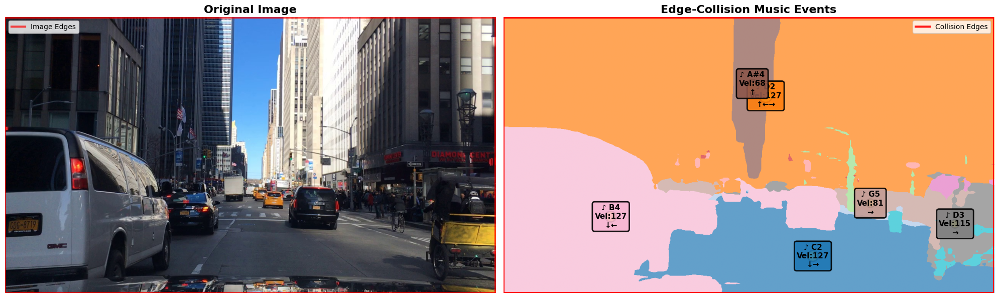


🎵 COMPLETE EDGE-COLLISION MUSIC MAPPING
🎯 ROAD → ♪ C2 (piano)
   Velocity: 127/127 | Duration: 0.19s
   Edges touched: bottom, right (2 edges)
   Presence: 14.9%

🎯 BUILDING → ♪ D2 (piano)
   Velocity: 127/127 | Duration: 2.03s
   Edges touched: top, left, right (3 edges)
   Presence: 51.3%

🎯 SKY → ♪ A#4 (piano)
   Velocity: 68/127 | Duration: 0.27s
   Edges touched: top (1 edges)
   Presence: 3.9%

🎯 PERSON → ♪ G5 (piano)
   Velocity: 81/127 | Duration: 0.37s
   Edges touched: right (1 edges)
   Presence: 2.7%

🎯 CAR → ♪ B4 (piano)
   Velocity: 127/127 | Duration: 0.36s
   Edges touched: bottom, left (2 edges)
   Presence: 22.3%

🎯 TRUCK → ♪ D3 (piano)
   Velocity: 115/127 | Duration: 0.53s
   Edges touched: right (1 edges)
   Presence: 2.8%

📊 SUMMARY: 6 edge-collision events generated

🎵 Synthesizing audio from 6 edge-collision music events...
🔊 Playing generated audio...
Music generation test completed successfully!



👆 Click the play button above to hear the generated music! 🎵


In [12]:
import numpy as np
from IPython.display import Audio, display

import os
import sys
sys.path.append(os.path.join(os.path.dirname(os.getcwd()), '..', '..'))
from modules.Music_Generator.Musician import Musician, TestMusician

def synthesize_audio(music_frame, sample_rate=44100, duration=3.0):
    """
    Convert MusicFrame events to audio waveform using piano-like synthesis.
    
    Args:
        music_frame: MusicFrame object with music events
        sample_rate: Audio sample rate (Hz)
        duration: Total duration of audio (seconds)
    
    Returns:
        numpy array with audio waveform
    """
    # Create time array
    t = np.linspace(0, duration, int(sample_rate * duration))
    audio = np.zeros_like(t)
    
    # Convert MIDI note to frequency
    def midi_to_freq(midi_note):
        return 440.0 * (2.0 ** ((midi_note - 69) / 12.0))
    
    # Synthesize each event as piano notes
    for event in music_frame.events:
        freq = midi_to_freq(event.note)
        velocity_factor = event.velocity / 127.0
        
        # Create piano-like sound for this event
        event_duration = min(event.duration, duration)
        event_samples = int(sample_rate * event_duration)
        
        if event_samples > 0:
            # Generate time array for this event
            t_event = np.linspace(0, event_duration, event_samples)
            
            # Piano-like envelope (sharp attack, gradual decay)
            envelope = np.exp(-2 * t_event / event_duration)  # Exponential decay
            
            # Piano-like waveform (fundamental + harmonics)
            fundamental = np.sin(2 * np.pi * freq * t_event)
            harmonic2 = 0.5 * np.sin(2 * np.pi * freq * 2 * t_event)  # Octave
            harmonic3 = 0.25 * np.sin(2 * np.pi * freq * 3 * t_event)  # Fifth
            
            # Combine harmonics for piano-like timbre
            wave = (fundamental + harmonic2 + harmonic3) * envelope
            
            # Apply velocity and mix into main audio
            wave *= velocity_factor * 0.2  # Scale down to prevent clipping
            
            # Add to main audio (simple mixing)
            if len(wave) <= len(audio):
                audio[:len(wave)] += wave
    
    # Normalize to prevent clipping
    if np.max(np.abs(audio)) > 0:
        audio = audio / np.max(np.abs(audio)) * 0.8
    
    return audio

def check_edge_collision(seg_map, class_id):
    """
    Check if a class touches any of the four edges of the image.
    
    Args:
        seg_map: Segmentation map
        class_id: Class ID to check
    
    Returns:
        dict: Which edges are touched {'top': bool, 'bottom': bool, 'left': bool, 'right': bool}
    """
    class_mask = (seg_map == class_id)
    height, width = seg_map.shape
    
    edges_touched = {
        'top': False,
        'bottom': False,
        'left': False,
        'right': False
    }
    
    if np.any(class_mask):
        # Check top edge (row 0)
        edges_touched['top'] = np.any(class_mask[0, :])
        
        # Check bottom edge (last row)
        edges_touched['bottom'] = np.any(class_mask[height-1, :])
        
        # Check left edge (column 0)
        edges_touched['left'] = np.any(class_mask[:, 0])
        
        # Check right edge (last column)
        edges_touched['right'] = np.any(class_mask[:, width-1])
    
    return edges_touched

def filter_edge_events(seg_map, music_frame):
    """
    Filter music events to only include those from objects touching image edges.
    
    Args:
        seg_map: Segmentation map
        music_frame: Original music frame
    
    Returns:
        Filtered music frame with only edge-touching events
    """
    filtered_events = []
    
    for event in music_frame.events:
        class_id = event.metadata.get('class_id', 0)
        class_name = event.metadata['class_name']
        
        # Check if this class touches any edge
        edges_touched = check_edge_collision(seg_map, class_id)
        
        if any(edges_touched.values()):  # If touches any edge
            # Add edge information to metadata
            event.metadata['edges_touched'] = edges_touched
            event.metadata['edge_collision'] = True
            
            # Count how many edges are touched
            num_edges_touched = sum(edges_touched.values())
            event.metadata['num_edges_touched'] = num_edges_touched
            
            # Increase velocity based on number of edges touched (more dramatic for corner objects)
            edge_multiplier = 1.0 + (num_edges_touched * 0.3)  # 30% boost per edge
            event.velocity = min(127, int(event.velocity * edge_multiplier))
            
            filtered_events.append(event)
    
    # Create new music frame with filtered events
    filtered_frame = type(music_frame)(
        events=filtered_events,
        frame_id=music_frame.frame_id,
        timestamp=music_frame.timestamp,
        tempo=music_frame.tempo,
        key_signature=music_frame.key_signature,
        metadata={
            **music_frame.metadata,
            'edge_filtered': True,
            'original_events_count': len(music_frame.events),
            'filtered_events_count': len(filtered_events)
        }
    )
    
    return filtered_frame

def visualize_music_on_segmentation_with_edges(seg_map, music_frame, original_image):
    """
    Visualize musical notes and instruments directly on the segmentation map,
    highlighting edge collisions.
    
    Args:
        seg_map: Segmentation map
        music_frame: Generated music frame (edge-filtered)
        original_image: Original image
    """
    # MIDI note to note name conversion
    def midi_to_note_name(midi_note):
        notes = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']
        octave = (midi_note // 12) - 1
        note = notes[midi_note % 12]
        return f"{note}{octave}"
    
    # Create figure with subplots
    fig, axes = plt.subplots(1, 2, figsize=(20, 10))
    
    # Plot 1: Original image (clean, no annotations)
    axes[0].imshow(original_image)
    axes[0].set_title("Original Image", fontsize=16, fontweight='bold')
    axes[0].axis('off')
    
    # Add edge indicators to original image
    height, width = original_image.shape[:2]
    # Draw edge lines
    axes[0].axhline(y=0, color='red', linewidth=3, alpha=0.7, label='Image Edges')
    axes[0].axhline(y=height-1, color='red', linewidth=3, alpha=0.7)
    axes[0].axvline(x=0, color='red', linewidth=3, alpha=0.7)
    axes[0].axvline(x=width-1, color='red', linewidth=3, alpha=0.7)
    axes[0].legend(loc='upper left')
    
    # Plot 2: Segmentation map with musical annotations
    # Create colormap for segmentation
    cityscapes_labels = [
        "road", "sidewalk", "building", "wall", "fence", "pole", "traffic light",
        "traffic sign", "vegetation", "terrain", "sky", "person", "rider", "car",
        "truck", "bus", "train", "motorcycle", "bicycle"
    ]
    
    colors = plt.colormaps.get_cmap('tab20').colors[:len(cityscapes_labels)]
    cmap = mcolors.ListedColormap(colors)
    
    axes[1].imshow(seg_map, cmap=cmap, vmin=0, vmax=len(cityscapes_labels)-1, alpha=0.7)
    axes[1].set_title("Edge-Collision Music Events", fontsize=16, fontweight='bold')
    axes[1].axis('off')
    
    # Use the same colormap for annotation boxes to match segmentation colors
    def get_class_color(class_id):
        """Get the color for a specific class from the segmentation colormap"""
        if class_id < len(colors):
            return colors[class_id]
        else:
            return colors[class_id % len(colors)]  # Wrap around if needed
    
    # Group events by class and find centroid of each segmented region
    events_by_class = {}
    for event in music_frame.events:
        class_id = event.metadata.get('class_id', 0)
        class_name = event.metadata['class_name']
        if class_id not in events_by_class:
            events_by_class[class_id] = {
                'event': event,
                'class_name': class_name
            }
    
    # Find centroids of each class region and add annotations
    for class_id, info in events_by_class.items():
        event = info['event']
        class_name = info['class_name']
        
        # Find pixels belonging to this class
        class_mask = (seg_map == class_id)
        
        if np.any(class_mask):
            # Find centroid of the class region
            y_coords, x_coords = np.where(class_mask)
            if len(y_coords) > 0:
                centroid_y = int(np.mean(y_coords))
                centroid_x = int(np.mean(x_coords))
                
                # Create annotation text
                note_name = midi_to_note_name(event.note)
                velocity = event.velocity
                
                # Get edge information
                edges_touched = event.metadata.get('edges_touched', {})
                edge_symbols = []
                if edges_touched.get('top'): edge_symbols.append('↑')
                if edges_touched.get('bottom'): edge_symbols.append('↓')
                if edges_touched.get('left'): edge_symbols.append('←')
                if edges_touched.get('right'): edge_symbols.append('→')
                
                edge_text = ''.join(edge_symbols) if edge_symbols else ''
                
                # Create clean annotation with just note and velocity
                annotation_text = f"♪ {note_name}\nVel:{velocity}\n{edge_text}"
                
                # Use segmentation map color for the annotation box
                seg_color = get_class_color(class_id)
                
                # Add annotation only to segmentation map
                bbox_props = dict(boxstyle="round,pad=0.3", facecolor=seg_color, alpha=0.9, edgecolor='black', linewidth=2)
                axes[1].text(centroid_x, centroid_y, annotation_text, 
                           fontsize=11, fontweight='bold', color='black', 
                           ha='center', va='center', bbox=bbox_props)
                
                # Add a circle with size based on number of edges touched
                num_edges = event.metadata.get('num_edges_touched', 1)
                circle_size = 8 + (num_edges * 3)  # Bigger circle for more edge touches
                circle = plt.Circle((centroid_x, centroid_y), circle_size, facecolor='yellow', fill=True, alpha=0.8, edgecolor='black', linewidth=2)
                axes[1].add_patch(circle)
    
    # Add edge indicators to segmentation map
    axes[1].axhline(y=0, color='red', linewidth=3, alpha=0.9, label='Collision Edges')
    axes[1].axhline(y=seg_map.shape[0]-1, color='red', linewidth=3, alpha=0.9)
    axes[1].axvline(x=0, color='red', linewidth=3, alpha=0.9)
    axes[1].axvline(x=seg_map.shape[1]-1, color='red', linewidth=3, alpha=0.9)
    axes[1].legend(loc='upper right', bbox_to_anchor=(1, 1), fontsize=10)
    
    plt.tight_layout()
    plt.show()

def print_complete_music_mapping(music_frame):
    """
    Print detailed music mapping for ALL events without truncation.
    
    Args:
        music_frame: Generated music frame (edge-filtered)
    """
    # MIDI note to note name conversion
    def midi_to_note_name(midi_note):
        notes = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']
        octave = (midi_note // 12) - 1
        note = notes[midi_note % 12]
        return f"{note}{octave}"
    
    # Print detailed music mapping
    print("\n" + "="*80)
    print("🎵 COMPLETE EDGE-COLLISION MUSIC MAPPING")
    print("="*80)
    
    if len(music_frame.events) == 0:
        print("🚫 No objects touching image edges - no music generated!")
        return
    
    # Group events by class
    events_by_class = {}
    for event in music_frame.events:
        class_id = event.metadata.get('class_id', 0)
        class_name = event.metadata['class_name']
        if class_id not in events_by_class:
            events_by_class[class_id] = {
                'event': event,
                'class_name': class_name
            }
    
    # Print all events in order
    for idx, (class_id, info) in enumerate(events_by_class.items(), 1):
        event = info['event']
        class_name = info['class_name']
        note_name = midi_to_note_name(event.note)
        
        edges_touched = event.metadata.get('edges_touched', {})
        edge_list = [edge for edge, touched in edges_touched.items() if touched]
        
        print(f"🎯 {class_name.upper()} → ♪ {note_name} (piano)")
        print(f"   Velocity: {event.velocity}/127 | Duration: {event.duration:.2f}s")
        print(f"   Edges touched: {', '.join(edge_list)} ({len(edge_list)} edges)")
        print(f"   Presence: {event.metadata.get('presence_ratio', 0):.1%}")
        print()
    
    print(f"📊 SUMMARY: {len(music_frame.events)} edge-collision events generated")
    print("="*80)

print("Testing main Musician class with 'test' type:")
musician = Musician(musician_type='test', tempo=120, key_signature="C_major")

# Use last segmentation map - need to extract the masks from YOLOv8 results
# Convert YOLOv8 results to segmentation map format
if hasattr(results2, 'masks') and results2.masks is not None:
    # Extract segmentation masks from YOLOv8 results
    masks = results2.masks.data.cpu().numpy()  # Shape: (N, H, W)
    seg_map = np.zeros((masks.shape[1], masks.shape[2]), dtype=int)
    
    # Assign class IDs to pixels based on masks
    for i, mask in enumerate(masks):
        class_id = int(results2.boxes.cls[i].cpu().numpy()) if results2.boxes is not None else i
        seg_map[mask > 0.5] = class_id
else:
    # If no masks, use the Segformer results instead
    print("No masks found in YOLOv8 results, using Segformer segmentation...")
    seg_map = results2

print(f"Segmentation map shape: {seg_map.shape}")
print(f"Unique classes in segmentation: {np.unique(seg_map)}")

# Generate music using the correct method (callable)
original_music_frame = musician(seg_map, frame_id=1)

print(f"Generated {len(original_music_frame.events)} total music events")

# Filter events to only include edge-colliding objects
filtered_music_frame = filter_edge_events(seg_map, original_music_frame)

print(f"Edge-collision events: {len(filtered_music_frame.events)} out of {len(original_music_frame.events)}")

# Visualize the music mapping for edge-collision events only
visualize_music_on_segmentation_with_edges(seg_map, filtered_music_frame, image)

# Print COMPLETE music mapping without truncation
print_complete_music_mapping(filtered_music_frame)

# Convert to audio and play (only edge-collision events)
if len(filtered_music_frame.events) > 0:
    print(f"\n🎵 Synthesizing audio from {len(filtered_music_frame.events)} edge-collision music events...")
    audio_data = synthesize_audio(filtered_music_frame, duration=4.0)
    
    print("🔊 Playing generated audio...")
    print("Music generation test completed successfully!")
    
    # Create and display audio widget
    audio_widget = Audio(audio_data, rate=44100, autoplay=False)
    display(audio_widget)
    
    print("\n👆 Click the play button above to hear the generated music! 🎵")
    
else:
    print("\n🔇 No edge-collision events found - no audio to play!")
    print("Try with an image where objects touch the edges.")